# Model Exploration Phrase 2

After having explored the logistic regression model, I have detected that the class imbalance in the target variable may be causing the logistic model to havea low recall score.

As mentioned before, next, I will be exploring the viability of using either a Decision Tree or Random Forest Classifier model to be used to predict PCB toxic level.

In [45]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings('ignore')
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [ ]:
#Only run this when using google.colab

# from google.colab import drive
# drive.mount('/content/drive')


In [46]:

file_path = '/content/drive/MyDrive/Colab Notebooks/PCB_df_v2.csv' #use this command if using Google Colab
PCB_df = pd.read_csv(file_path, low_memory=False, index_col=0)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [47]:


# PCB_df = pd.read_csv('PCB_df_v2.csv', low_memory=False, index_col=0) #use this command if running in Jupyter Notebook



In [48]:
PCB_df.drop_duplicates(inplace=True) #Dropping the duplicates since models does not do well with these

In [49]:
PCB_df.head()

,OrganismID_Number,Latitude,Longitude,WeightAvg(g),TLMax(mm),TLAvgLength(mm),CompositeLatitude,CompositeLongitude,TotalLength(mm),OrganismWeight(g),...,CommonName_Jacksmelt,CommonName_Largemouth Bass,CommonName_Rainbow Trout,CommonName_Shiner Surfperch,CommonName_Spotted Sand Bass,CommonName_Striped Bass,CommonName_Striped Mullet,CommonName_Tilapia spp.,CommonName_Top Smelt,CommonName_White Croaker
0,0,33.771563,-118.133022,29.692,10.6,10.6,33.7716,-118.133,1.06,-88.0,...,0,0,0,0,0,0,0,0,1,0
2,0,33.771563,-118.133022,29.692,10.6,10.6,33.7716,-118.133,1.06,-88.0,...,0,0,0,0,0,0,0,0,1,0
4,0,33.771563,-118.133022,29.692,10.6,10.6,33.7716,-118.133,1.06,-88.0,...,0,0,0,0,0,0,0,0,1,0
6,0,33.771563,-118.133022,29.692,10.6,10.6,33.7716,-118.133,1.06,-88.0,...,0,0,0,0,0,0,0,0,1,0
8,0,33.771563,-118.133022,29.692,10.6,10.6,33.7716,-118.133,1.06,-88.0,...,0,0,0,0,0,0,0,0,1,0


In [50]:
PCB_df.shape

(40263, 41)

## Train/test Sets Preparations

Same as before, I prepare the train and test sets by remove features that has a high colinarity and VIF score. To produce a fair comparision, I dropped the same feature columns and in the same order as I did for the logistic model.

In [51]:
X = PCB_df.drop('PCB_threshold', axis=1)
y = PCB_df['PCB_threshold'].copy()

In [52]:
y.value_counts()

,count
PCB_threshold,
0,36827
1,3436


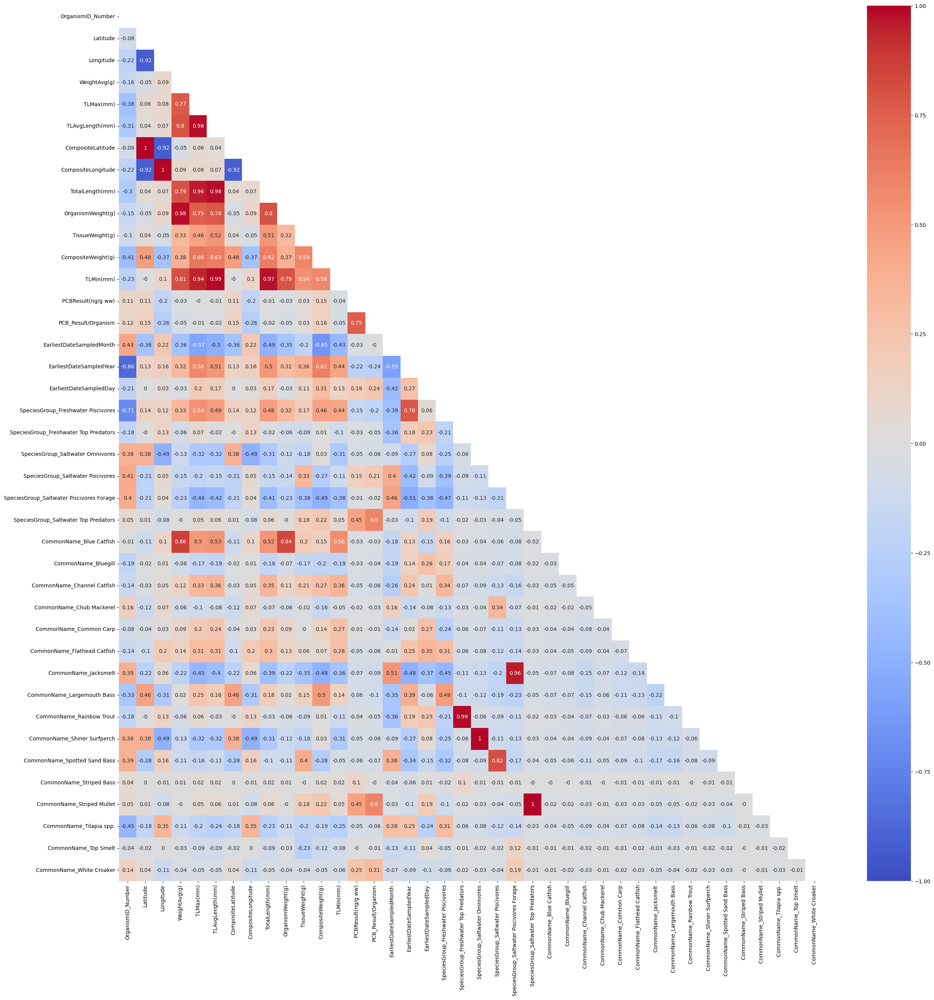

In [53]:
# Calculate all the correlations between each independent variable
corr_df = X.corr()

# Mask for upper triangular
mask = np.triu(corr_df)

# Visualize
plt.figure(figsize=(30,30))
sns.heatmap(corr_df.round(2), annot=True, vmax=1, vmin=-1, center=0, cmap='coolwarm', mask=mask)
plt.show()

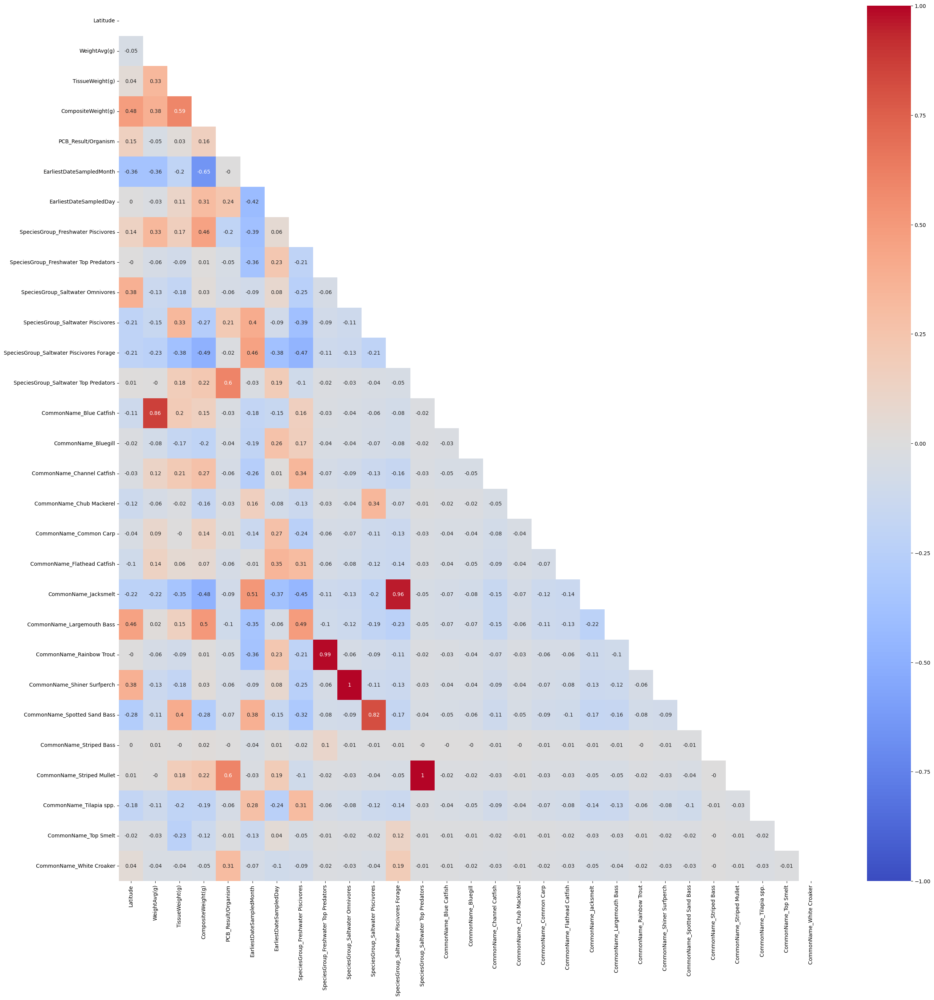

In [54]:
X_drop_col = ['Longitude', 'TLMax(mm)', 'TLAvgLength(mm)',
       'CompositeLatitude','CompositeLongitude','TotalLength(mm)',
       'OrganismWeight(g)',
       'TLMin(mm)', 'PCBResult(ng/g ww)',
       'OrganismID_Number', 'EarliestDateSampledYear'
       ]
X.drop(columns=X_drop_col, inplace=True)

corr_df = X.corr()

# Mask for upper triangular
mask = np.triu(corr_df)

# Visualize
plt.figure(figsize=(30,30))
sns.heatmap(corr_df.round(2), annot=True, vmax=1, vmin=-1, center=0, cmap='coolwarm', mask=mask)
plt.show()

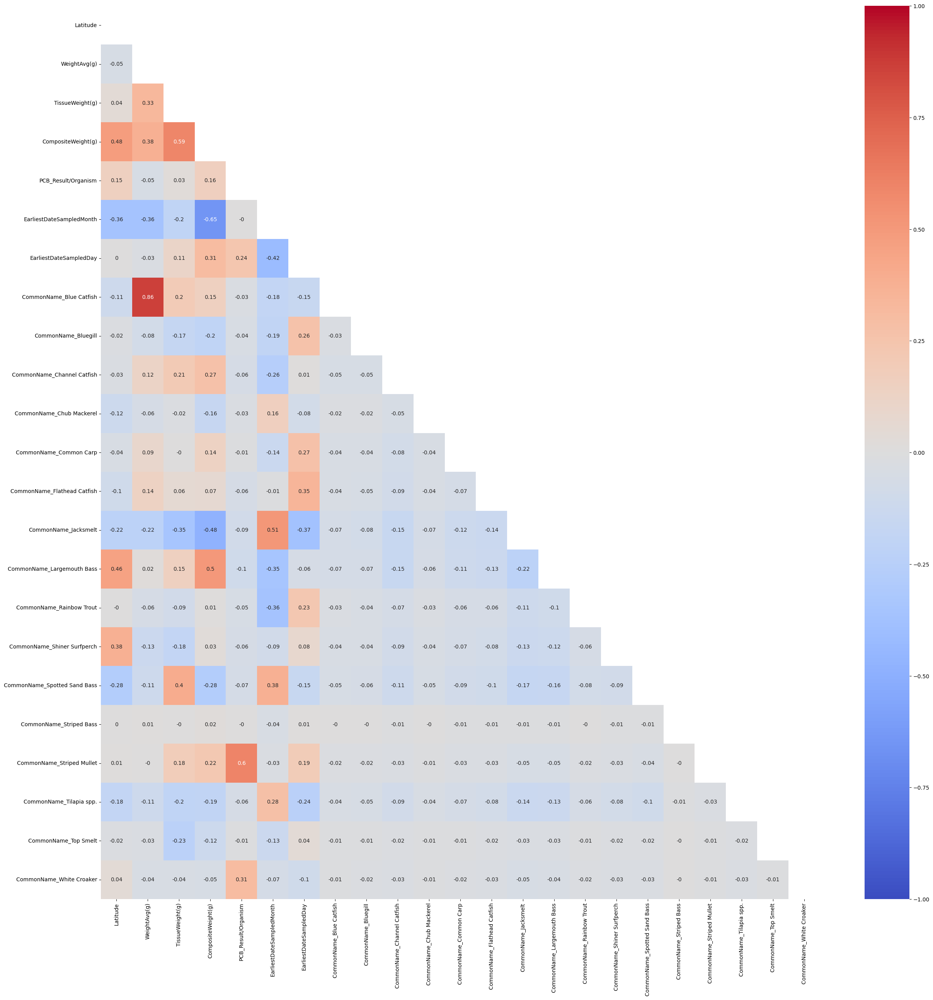

In [55]:

columns_with_speciesgroup = [col for col in X.columns if 'SpeciesGroup' in col]


X.drop(columns=columns_with_speciesgroup, inplace=True)

# Calculate all the correlations between each independent variable
corr_df = X.corr()

# Mask for upper triangular
mask = np.triu(corr_df)

# Visualize
plt.figure(figsize=(30,30))
sns.heatmap(corr_df.round(2), annot=True, vmax=1, vmin=-1, center=0, cmap='coolwarm', mask=mask)
plt.show()

## Detecting Multicolinearity with VIF Values

In [56]:
X_withconstant = sm.add_constant(X)
variance_inflation_factor(X_withconstant, 1)
pd.Series([variance_inflation_factor(X_withconstant.values, i)
          for i in range(X_withconstant.shape[1])],
         index=X_withconstant.columns)[1:] # leaving out the constant


,0
Latitude,2.977871
WeightAvg(g),8.459994
TissueWeight(g),6.772720
CompositeWeight(g),12.118969
PCB_Result/Organism,11.466855
EarliestDateSampledMonth,8.380820
EarliestDateSampledDay,3.579646
CommonName_Blue Catfish,12.543376
CommonName_Bluegill,8.593318
CommonName_Channel Catfish,20.433239


In [57]:
X.drop(columns=['WeightAvg(g)'], inplace=True)
X_withconstant = sm.add_constant(X)
variance_inflation_factor(X_withconstant, 1)
pd.Series([variance_inflation_factor(X_withconstant.values, i)
          for i in range(X_withconstant.shape[1])],
         index=X_withconstant.columns)[1:] # leaving out the constant


,0
Latitude,2.974290
TissueWeight(g),6.772569
CompositeWeight(g),12.015738
PCB_Result/Organism,11.354110
EarliestDateSampledMonth,7.917712
EarliestDateSampledDay,3.421213
CommonName_Blue Catfish,6.151813
CommonName_Bluegill,8.574983
CommonName_Channel Catfish,20.008269
CommonName_Chub Mackerel,6.273633


In [58]:
X.drop(columns=['TissueWeight(g)'], inplace=True)
X_withconstant = sm.add_constant(X)
variance_inflation_factor(X_withconstant, 1)
pd.Series([variance_inflation_factor(X_withconstant.values, i)
          for i in range(X_withconstant.shape[1])],
         index=X_withconstant.columns)[1:] # leaving out the constant


,0
Latitude,2.958444
CompositeWeight(g),5.788121
PCB_Result/Organism,10.969354
EarliestDateSampledMonth,7.534850
EarliestDateSampledDay,3.286926
CommonName_Blue Catfish,6.149615
CommonName_Bluegill,8.544323
CommonName_Channel Catfish,19.903509
CommonName_Chub Mackerel,6.073219
CommonName_Common Carp,13.324022


In [59]:
X.drop(columns=['CompositeWeight(g)'], inplace=True)
X_withconstant = sm.add_constant(X)
variance_inflation_factor(X_withconstant, 1)
pd.Series([variance_inflation_factor(X_withconstant.values, i)
          for i in range(X_withconstant.shape[1])],
         index=X_withconstant.columns)[1:] # leaving out the constant


,0
Latitude,2.462160
PCB_Result/Organism,10.430675
EarliestDateSampledMonth,6.417266
EarliestDateSampledDay,2.976018
CommonName_Blue Catfish,6.122327
CommonName_Bluegill,6.810568
CommonName_Channel Catfish,19.547476
CommonName_Chub Mackerel,5.761324
CommonName_Common Carp,12.854385
CommonName_Flathead Catfish,17.346619


In [60]:
X.drop(columns=['EarliestDateSampledDay'], inplace=True)
X_withconstant = sm.add_constant(X)
variance_inflation_factor(X_withconstant, 1)
pd.Series([variance_inflation_factor(X_withconstant.values, i)
          for i in range(X_withconstant.shape[1])],
         index=X_withconstant.columns)[1:] # leaving out the constant


,0
Latitude,2.131032
PCB_Result/Organism,9.871012
EarliestDateSampledMonth,6.397679
CommonName_Blue Catfish,6.065670
CommonName_Bluegill,6.561128
CommonName_Channel Catfish,19.528299
CommonName_Chub Mackerel,5.751541
CommonName_Common Carp,12.584420
CommonName_Flathead Catfish,16.902358
CommonName_Jacksmelt,37.535328


In [61]:
X.drop(columns=['EarliestDateSampledMonth'], inplace=True)
X_withconstant = sm.add_constant(X)
variance_inflation_factor(X_withconstant, 1)
pd.Series([variance_inflation_factor(X_withconstant.values, i)
          for i in range(X_withconstant.shape[1])],
         index=X_withconstant.columns)[1:] # leaving out the constant


,0
Latitude,2.126019
PCB_Result/Organism,9.648891
CommonName_Blue Catfish,6.033880
CommonName_Bluegill,6.523602
CommonName_Channel Catfish,19.517955
CommonName_Chub Mackerel,5.342683
CommonName_Common Carp,12.580381
CommonName_Flathead Catfish,16.698674
CommonName_Jacksmelt,34.562945
CommonName_Largemouth Bass,32.255766


In [62]:
# I am dropping this even though the VIF is low since this is another target variable for the other model

X.drop(columns=['PCB_Result/Organism'], inplace=True)
X_withconstant = sm.add_constant(X)
variance_inflation_factor(X_withconstant, 1)
pd.Series([variance_inflation_factor(X_withconstant.values, i)
          for i in range(X_withconstant.shape[1])],
         index=X_withconstant.columns)[1:] # leaving out the constant


,0
Latitude,2.120541
CommonName_Blue Catfish,2.087641
CommonName_Bluegill,2.098734
CommonName_Channel Catfish,4.717981
CommonName_Chub Mackerel,1.950171
CommonName_Common Carp,3.474574
CommonName_Flathead Catfish,4.217513
CommonName_Jacksmelt,8.019247
CommonName_Largemouth Bass,6.729904
CommonName_Rainbow Trout,2.920137


## Decision Tree Classifier Base Model

As part of my exploration, I will first divide the data set up into a train set, a validation set, and a test set in order to visualize which max_depth would be the most optimal.

In [63]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.tree import plot_tree


In [64]:
# Taking a chuck for our 20% test set

X_remainder, X_test, y_remainder, y_test = \
    train_test_split(X, y, test_size = 0.2,
                     random_state=41)

# Splitting the remainder in two chunks

X_train, X_validation, y_train, y_validation = \
    train_test_split(X_remainder, y_remainder, test_size = 0.3,
                     random_state=41)

In [65]:
print(f'Shape of test set: {X_test.shape}')
print(f'Shape of validation set: {X_validation.shape}')
print(f'Shape of train set: {X_train.shape}')

Shape of test set: (8053, 17)
Shape of validation set: (9663, 17)
Shape of train set: (22547, 17)


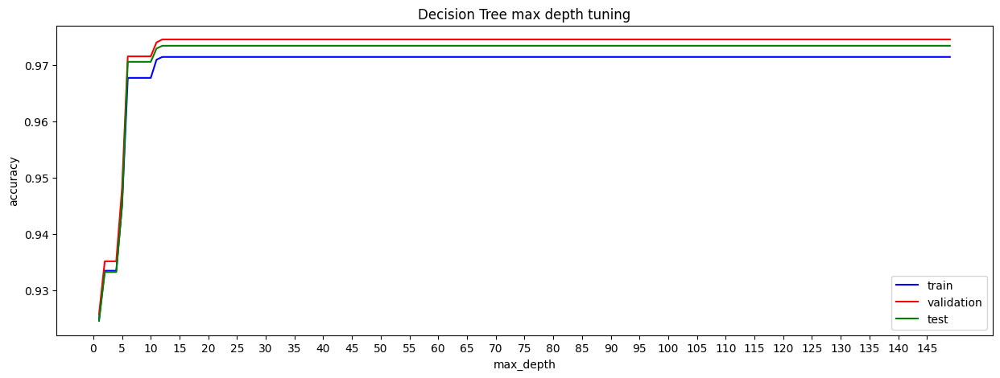

In [66]:
depths = list(range(1, int(np.sqrt(len(X_train)))))
tree_train_scores = []
tree_val_scores = []
tree_test_scores = []

for d in depths:
    dt = DecisionTreeClassifier(max_depth=d)
    dt.fit(X_train, y_train)

    # evaluate
    tree_train_scores.append(dt.score(X_train, y_train))
    tree_val_scores.append(dt.score(X_validation, y_validation))
    tree_test_scores.append(dt.score(X_test, y_test))

plt.figure(figsize=(15, 5))
plt.plot(depths, tree_train_scores, c='blue', label='train')
plt.plot(depths, tree_val_scores, c='red', label='validation')
plt.plot(depths, tree_test_scores, c='green', label='test')

plt.xlabel('max_depth')
plt.ylabel('accuracy')
plt.xticks(np.arange(0, 150, step=5))
plt.title('Decision Tree max depth tuning')
plt.legend()
plt.show()

In [67]:

DT_model = DecisionTreeClassifier(max_depth=20)
DT_model.fit(X_train, y_train)

print(f"The TRAIN classification accuracy is:  {DT_model.score(X_train,y_train)}")
print(f"The TEST classification accuracy is:  {DT_model.score(X_test,y_test)}")

The TRAIN classification accuracy is:  0.9714374417882645
The TEST classification accuracy is:  0.9734260524028312


The accuracy score is already higher than that of the logistic model, which was 95.5%. Now let's plot the tree to look at how the model is making the splits.

Since Decision Trees does not rely on p-value, we are able to keep all of the species features.

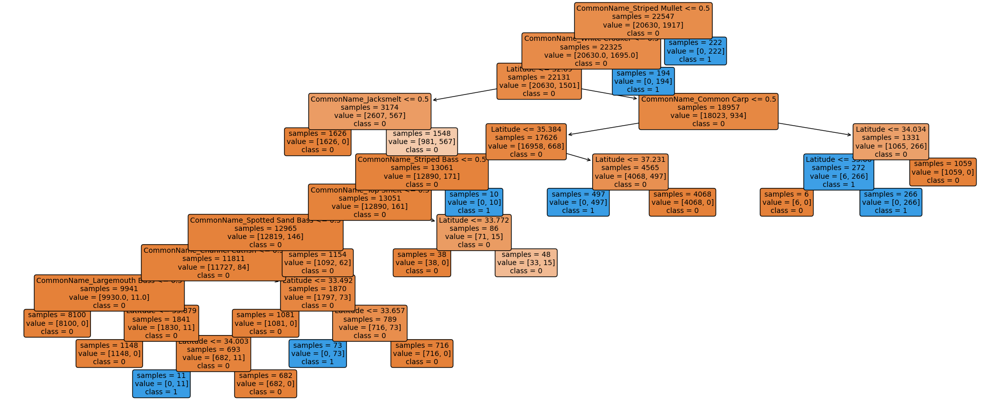

In [68]:
fig, ax = plt.subplots(figsize=(25,10))

plot_tree(DT_model, feature_names = X.columns.to_list(), class_names= ['0', '1'],
          rounded = True, impurity=False, ax=ax, filled=True, fontsize=10);

## First Model Evaluation - Confusion Matrix

In [69]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Get class predictions
y_pred_dt = DT_model.predict(X_test)

# Generate confusion matrix
cf_matrix = confusion_matrix(y_test, y_pred_dt)

# label rows and columns
cf_df = pd.DataFrame(
    cf_matrix,
    columns=["Predicted Non-Toxic", "Predicted Toxic"],
    index=["True Non-Toxic", "True Toxic"]
)

display(cf_df)

,Predicted Non-Toxic,Predicted Toxic
True Non-Toxic,7362,0
True Toxic,214,477


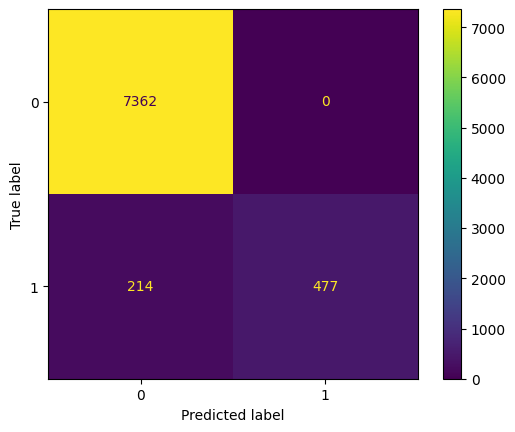

In [70]:
ConfusionMatrixDisplay.from_estimator(DT_model, X_test, y_test);

In [71]:
from sklearn.metrics import classification_report

report_initial = classification_report(y_test, y_pred_dt)
print(report_initial)

              precision    recall  f1-score   support

           0       0.97      1.00      0.99      7362
           1       1.00      0.69      0.82       691

    accuracy                           0.97      8053
   macro avg       0.99      0.85      0.90      8053
weighted avg       0.97      0.97      0.97      8053



The recall score is significantly higher than that of the logistic model's. It is over the 60% threshold, which means that the model can detect 66% of true positive out of the dataset.

## Random Forest Classifier

Since Decision Trees are prone to being over-fitted, one way to improve this is through ensemble learning. Especially with imbalance classes, random forest models then to perform better than decision tree models.

First, I run a graph to see how many components my model should have to optimize results.


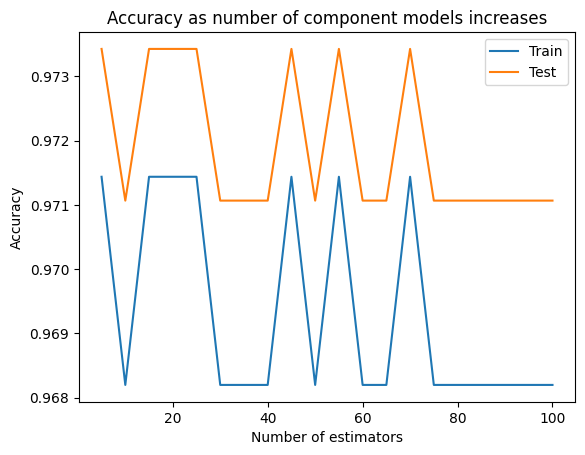

In [85]:
#fitting the Random Forest Model

from sklearn.ensemble import RandomForestClassifier


# Looking for the best number of n_estimators
train_scores = []
test_scores = []
n_range = range(5, 101, 5)
for n in n_range:
    random_forest_model = RandomForestClassifier(n_estimators = n, max_depth = 10)
    random_forest_model.fit(X_train, y_train)
    train_scores.append(random_forest_model.score(X_train, y_train))
    test_scores.append(random_forest_model.score(X_test, y_test))

plt.plot(n_range, train_scores, label = 'Train')
plt.plot(n_range, test_scores, label = 'Test')
plt.xlabel("Number of estimators")
plt.ylabel("Accuracy")
plt.title("Accuracy as number of component models increases")
plt.legend();

I chose to use 20 estimators with a max_depth of 10.


In [73]:
random_forest_model = RandomForestClassifier(n_estimators = 20, max_depth = 10)
random_forest_model.fit(X_train, y_train)

RandomForestClassifier(max_depth=10, n_estimators=20)

In [74]:
# Get class predictions
y_pred_rf = random_forest_model.predict(X_test)

# Generate confusion matrix
cf_matrix = confusion_matrix(y_test, y_pred_rf)

# label rows and columns
cf_df = pd.DataFrame(
    cf_matrix,
    columns=["Predicted Non-Toxic", "Predicted Toxic"],
    index=["True Non-Toxic", "True Toxic"]
)

display(cf_df)

,Predicted Non-Toxic,Predicted Toxic
True Non-Toxic,7362,0
True Toxic,214,477


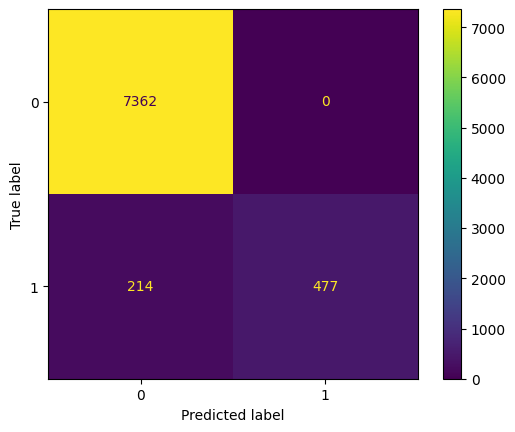

In [75]:
ConfusionMatrixDisplay.from_estimator(random_forest_model, X_test, y_test);

In [76]:
report_initial = classification_report(y_test, y_pred_rf)
print(report_initial)

              precision    recall  f1-score   support

           0       0.97      1.00      0.99      7362
           1       1.00      0.69      0.82       691

    accuracy                           0.97      8053
   macro avg       0.99      0.85      0.90      8053
weighted avg       0.97      0.97      0.97      8053



The recall score is higher than that of a decision tree at 69%.

## Scaling and PCA Comparison

Even though decision tree and random forest models are not sensitve to scaling, I want to see if it makes a difference in their performances

In [86]:
from mlxtend.plotting import plot_decision_regions
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


First, scale the data with a standard scaler. I chose this scaler since it is considered the most standard used one, and it tends to perform well with classification data.

In [87]:
# 1. Train and test split
split = 0.20
RF_X_train, RF_X_test, RF_y_train, RF_y_test = train_test_split(X, y, test_size=split, random_state=41)

# 2. Scale data
scaler = StandardScaler()
scaler.fit(RF_X_train)
RFS_X_train = scaler.transform(RF_X_train)
RFS_X_test = scaler.transform(RF_X_test)

print(f'Shape of train set: {RFS_X_train.shape}')
print(f'Shape of test set: {RFS_X_test.shape}')

Shape of train set: (32210, 17)
Shape of test set: (8053, 17)


Next, I look at the two PCA methods and see which one fits best.

In [88]:
# 3. Instantiate & fit PCA model

my_PCA = PCA()
my_PCA.fit(RFS_X_train)

# 4. transform data
X_train_PCA = my_PCA.transform(RFS_X_train)
X_test_PCA = my_PCA.transform(RFS_X_test)

In [89]:
print(f"Variance captured by PC1: {my_PCA.explained_variance_[0]: 0.3f}")
print(f"Variance captured by PC2: {my_PCA.explained_variance_[1]: 0.3f}")

print(f"Proportion of variance captured by PC1: {my_PCA.explained_variance_ratio_[0]: 0.3f}")
print(f"Proportion of variance captured by PC2: {my_PCA.explained_variance_ratio_[1]: 0.3f}")

Variance captured by PC1:  1.827
Variance captured by PC2:  1.195
Proportion of variance captured by PC1:  0.107
Proportion of variance captured by PC2:  0.070


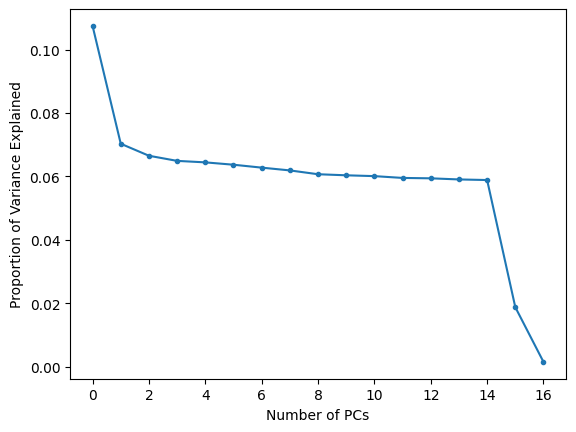

In [90]:
expl_var = my_PCA.explained_variance_ratio_

plt.figure()
plt.plot(expl_var,marker='.')
plt.xlabel('Number of PCs')
plt.ylabel('Proportion of Variance Explained')
plt.show()

It looks like the number of variance quickly drops after 14 features.

In [91]:
#Method 2
# Calculate the cumulative sum of this array using the
cumulative_sum = np.cumsum(expl_var)

cumulative_sum

array([0.10747461, 0.17777464, 0.24428401, 0.30917837, 0.3735997 ,
       0.4372805 , 0.50004171, 0.5619261 , 0.62260332, 0.68294536,
       0.74302676, 0.80253982, 0.8619276 , 0.92096324, 0.97981252,
       0.99854163, 1.        ])

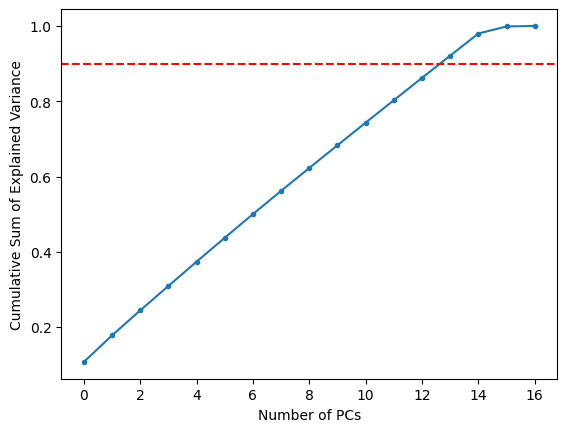

In [92]:
# Plot out the cumulative sum graph

plt.figure()
plt.plot( cumulative_sum, marker='.')
plt.axhline(0.9, c='r', linestyle='--')
plt.xlabel('Number of PCs')
plt.ylabel('Cumulative Sum of Explained Variance')
plt.show()

Looking at the graph, 14 components is where 90% of the variances would be captured.

In [93]:
# Instantiate & fit PCA model

my_PCA = PCA(n_components = 0.9)
my_PCA.fit(RFS_X_train)

# transform data
X_train_PCA = my_PCA.transform(RFS_X_train)
X_test_PCA = my_PCA.transform(RFS_X_test)

print(f'Original: {RFS_X_train.shape}')
print(f'PCA Transformed: {X_train_PCA.shape}')

Original: (32210, 17)
PCA Transformed: (32210, 14)


## Decision Tree on Scaled & PCA Sets

In [94]:
DT_model_pca = DecisionTreeClassifier(max_depth=10)
DT_model_pca.fit(X_train_PCA, RF_y_train)

print(f"The TRAIN classification accuracy is:  {DT_model_pca.score(X_train_PCA, RF_y_train)}")
print(f"The TEST classification accuracy is:  {DT_model_pca.score(X_train_PCA, RF_y_train)}")

The TRAIN classification accuracy is:  0.9723688295560385
The TEST classification accuracy is:  0.9723688295560385


In [95]:
# Get class predictions
y_pred_dt_pca = DT_model_pca.predict(X_test_PCA)

# Generate confusion matrix
cf_matrix = confusion_matrix(RF_y_test, y_pred_dt_pca)

# label rows and columns
cf_df = pd.DataFrame(
    cf_matrix,
    columns=["Predicted Non-Toxic", "Predicted Toxic"],
    index=["True Non-Toxic", "True Toxic"]
)

display(cf_df)

,Predicted Non-Toxic,Predicted Toxic
True Non-Toxic,7362,0
True Toxic,214,477


In [96]:
report_initial = classification_report(RF_y_test, y_pred_dt_pca)
print(report_initial)

              precision    recall  f1-score   support

           0       0.97      1.00      0.99      7362
           1       1.00      0.69      0.82       691

    accuracy                           0.97      8053
   macro avg       0.99      0.85      0.90      8053
weighted avg       0.97      0.97      0.97      8053



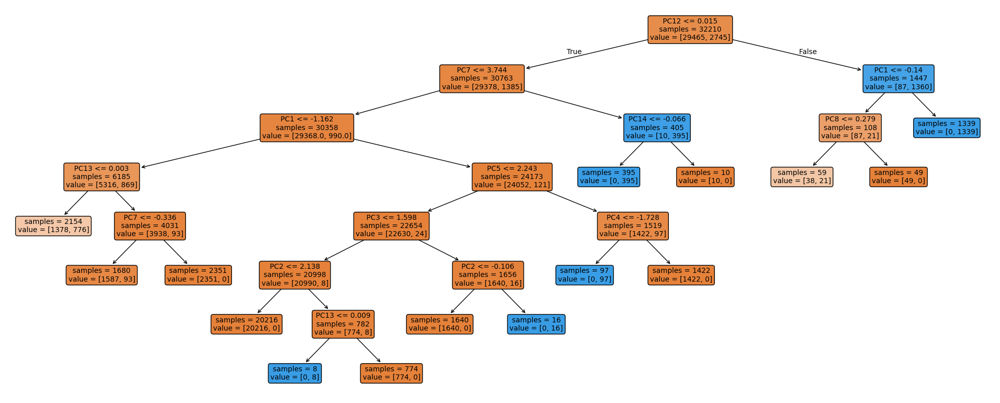

In [97]:
fig, ax = plt.subplots(figsize=(25,10))



plot_tree(DT_model_pca,
          feature_names = [f"PC{i+1}" for i in range(X_train_PCA.shape[1])],
          rounded = True, impurity=False, ax=ax, filled=True, fontsize=10);

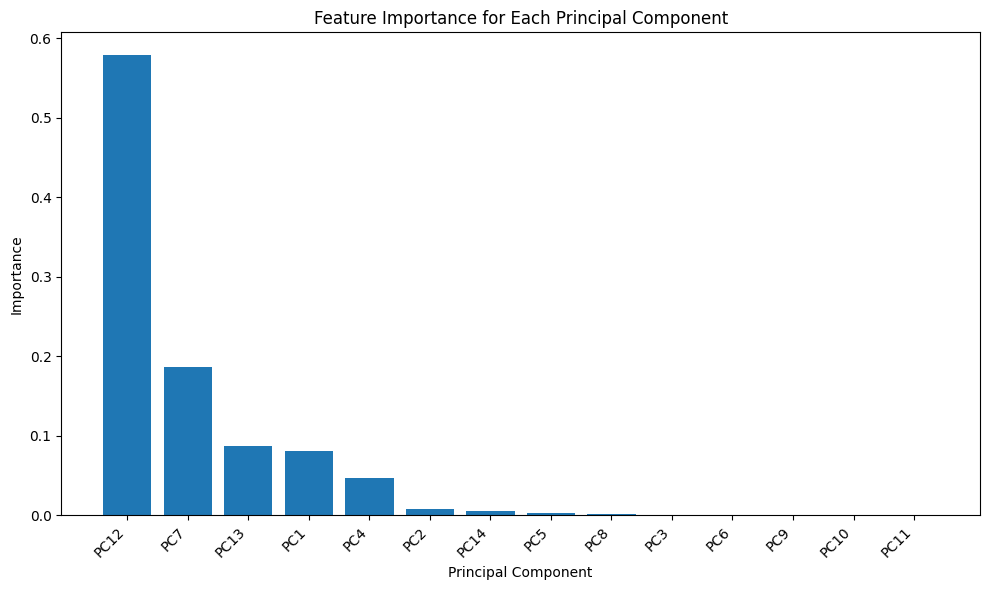

Principal Component 1:
Principal Component 2:
Principal Component 3:
Principal Component 4:
Principal Component 5:
Principal Component 6:
Principal Component 7:
Principal Component 8:
Principal Component 9:
Principal Component 10:
Principal Component 11:
Principal Component 12:
Principal Component 13:
Principal Component 14:


,Feature,Loading
15,CommonName_Top Smelt,0.994023
12,CommonName_Striped Bass,0.021286
0,Latitude,-0.001662
8,CommonName_Largemouth Bass,-0.004495
10,CommonName_Shiner Surfperch,-0.005149
7,CommonName_Jacksmelt,-0.009343
3,CommonName_Channel Catfish,-0.012505
11,CommonName_Spotted Sand Bass,-0.015200
6,CommonName_Flathead Catfish,-0.015537
5,CommonName_Common Carp,-0.016631


In [101]:

# Get feature importances from the PCA-transformed Decision Tree model
importances = DT_model_pca.feature_importances_

# Create a DataFrame to store the importances and PC names
importances_df = pd.DataFrame({'PC': [f"PC{i+1}" for i in range(X_train_PCA.shape[1])], 'Importance': importances})

# Sort the DataFrame by importance in descending order
importances_df = importances_df.sort_values(by='Importance', ascending=False)


# Create a bar plot of feature importances
plt.figure(figsize=(10, 6))
plt.bar(importances_df['PC'], importances_df['Importance'])
plt.xlabel('Principal Component')
plt.ylabel('Importance')
plt.title('Feature Importance for Each Principal Component')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#

loadings = my_PCA.components_
num_pc = loadings.shape[0]
num_features = loadings.shape[1]

feature_names = X.columns #feature names from original dataset

for i in range(num_pc):
    print(f"Principal Component {i+1}:")
    component_loadings = pd.DataFrame({'Feature': feature_names, 'Loading': loadings[i, :]})
    component_loadings = component_loadings.sort_values(by='Loading', ascending=False)
component_loadings


### Evaluation:

It is very interesting to see that the inverse has happened. Now Top Smelt is the most important feature instead of mullet, athough the recall & f-1 score didn't change from the decision tree model without the scaling and PCA.

## Random Forest on Scaled and PCA Sets


First, I run the same graph to determine the best number of components for the model. This time I had to decrease the max_depth to 6.

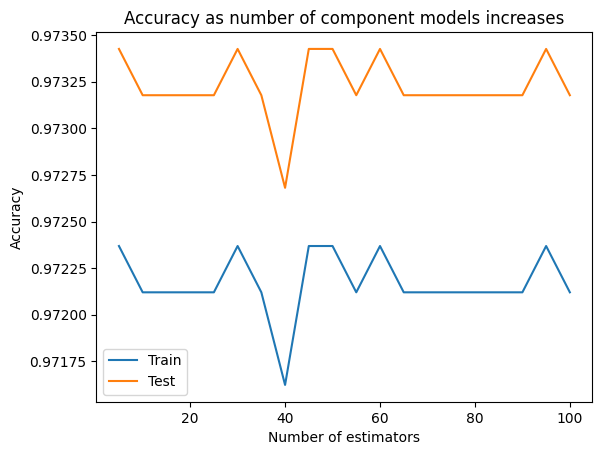

In [102]:

# Looking for the best number of n_estimators
train_scores = []
test_scores = []
n_range = range(5, 101, 5)
for n in n_range:
    RF_model_pca = RandomForestClassifier(n_estimators = n, max_depth = 6)
    RF_model_pca.fit(X_train_PCA, RF_y_train)
    train_scores.append(RF_model_pca.score(X_train_PCA, RF_y_train))
    test_scores.append(RF_model_pca.score(X_test_PCA, RF_y_test))

plt.plot(n_range, train_scores, label = 'Train')
plt.plot(n_range, test_scores, label = 'Test')
plt.xlabel("Number of estimators")
plt.ylabel("Accuracy")
plt.title("Accuracy as number of component models increases")
plt.legend();

In [103]:

#fitting the Random Forest Model
RF_model_pca = RandomForestClassifier(n_estimators=60, max_depth=6 )
RF_model_pca.fit(X_train_PCA, RF_y_train)

RandomForestClassifier(max_depth=6, n_estimators=60)

In [104]:
# Instantiate lists to save scores in
decision_tree_train_scores = []
decision_tree_test_scores = []
# For each tree, score on train and test
for sub_tree in RF_model_pca.estimators_:
    decision_tree_train_scores.append(sub_tree.score(X_train_PCA, RF_y_train))
    decision_tree_test_scores.append(sub_tree.score(X_test_PCA, RF_y_test))

# Rather than many separate print() statements, we can combine them into one using triple quotes.
print(f"""
Performance on fitted data:
Average Decision Tree: {np.mean(decision_tree_train_scores)}
Random Forest: {RF_model_pca.score(X_train_PCA, RF_y_train)}
----------------
Performance on test data:
Average Decision Tree: {np.mean(decision_tree_test_scores)}
Random Forest: {RF_model_pca.score(X_test_PCA, RF_y_test)}
""")


Performance on fitted data:
Average Decision Tree: 0.9714814239884094
Random Forest: 0.9721204594846321
----------------
Performance on test data:
Average Decision Tree: 0.9724885135974171
Random Forest: 0.9731776977523904



In [105]:
# Get class predictions
y_pred_rf_pca = RF_model_pca.predict(X_test_PCA)

# Generate confusion matrix
cf_matrix = confusion_matrix(RF_y_test, y_pred_rf_pca)

# label rows and columns
cf_df = pd.DataFrame(
    cf_matrix,
    columns=["Predicted Non-Toxic", "Predicted Toxic"],
    index=["True Non-Toxic", "True Toxic"]
)

display(cf_df)

,Predicted Non-Toxic,Predicted Toxic
True Non-Toxic,7362,0
True Toxic,216,475


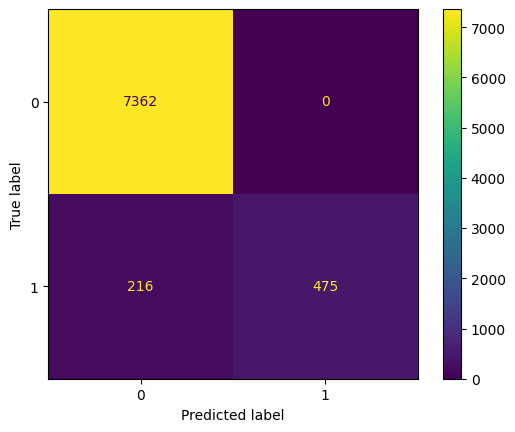

In [106]:
ConfusionMatrixDisplay.from_estimator(RF_model_pca, X_test_PCA, RF_y_test);

In [107]:
report_initial = classification_report(RF_y_test, y_pred_rf_pca)
print(report_initial)

              precision    recall  f1-score   support

           0       0.97      1.00      0.99      7362
           1       1.00      0.69      0.81       691

    accuracy                           0.97      8053
   macro avg       0.99      0.84      0.90      8053
weighted avg       0.97      0.97      0.97      8053



The scoring didn't improve much from the model based on raw data.

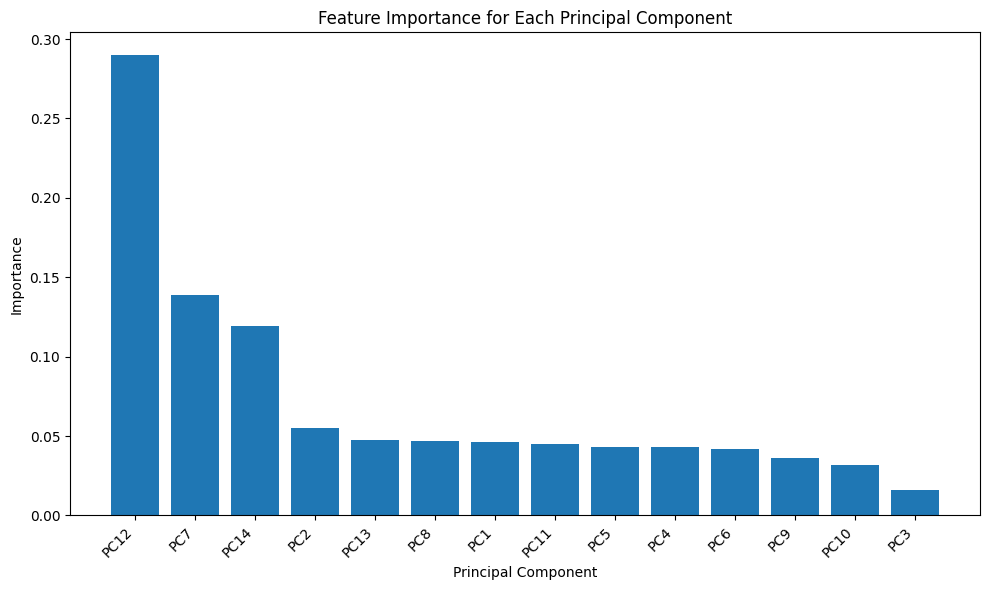

Principal Component 1:
Principal Component 2:
Principal Component 3:
Principal Component 4:
Principal Component 5:
Principal Component 6:
Principal Component 7:
Principal Component 8:
Principal Component 9:
Principal Component 10:
Principal Component 11:
Principal Component 12:
Principal Component 13:
Principal Component 14:


,Feature,Loading
15,CommonName_Top Smelt,0.994023
12,CommonName_Striped Bass,0.021286
0,Latitude,-0.001662
8,CommonName_Largemouth Bass,-0.004495
10,CommonName_Shiner Surfperch,-0.005149
7,CommonName_Jacksmelt,-0.009343
3,CommonName_Channel Catfish,-0.012505
11,CommonName_Spotted Sand Bass,-0.015200
6,CommonName_Flathead Catfish,-0.015537
5,CommonName_Common Carp,-0.016631


In [111]:
# Get feature importances from the PCA-transformed Decision Tree model
importances = RF_model_pca.feature_importances_

# Create a DataFrame to store the importances and PC names
importances_df = pd.DataFrame({'PC': [f"PC{i+1}" for i in range(X_train_PCA.shape[1])], 'Importance': importances})

# Sort the DataFrame by importance in descending order
importances_df = importances_df.sort_values(by='Importance', ascending=False)


# Create a bar plot of feature importances
plt.figure(figsize=(10, 6))
plt.bar(importances_df['PC'], importances_df['Importance'])
plt.xlabel('Principal Component')
plt.ylabel('Importance')
plt.title('Feature Importance for Each Principal Component')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#

loadings = my_PCA.components_
num_pc = loadings.shape[0]
num_features = loadings.shape[1]

feature_names = X.columns #feature names from original dataset

for i in range(num_pc):
    print(f"Principal Component {i+1}:")
    component_loadings = pd.DataFrame({'Feature': feature_names, 'Loading': loadings[i, :]})
    component_loadings = component_loadings.sort_values(by='Loading', ascending=False)
component_loadings

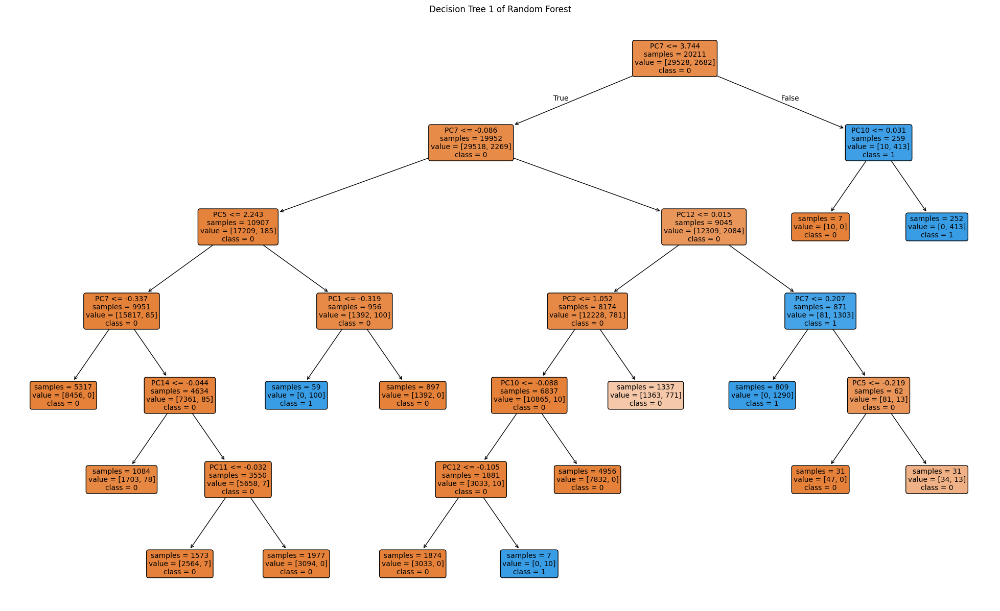

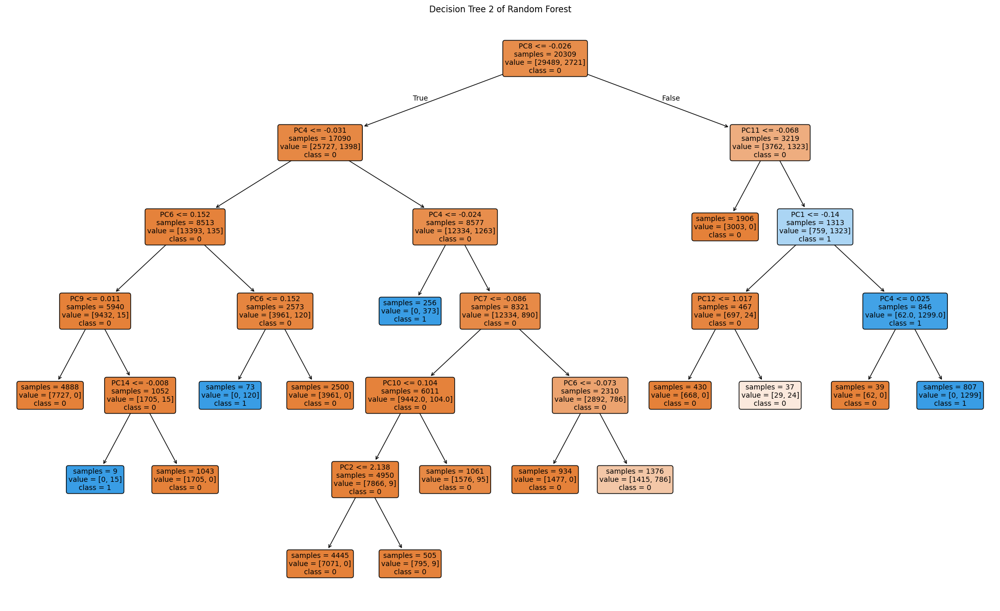

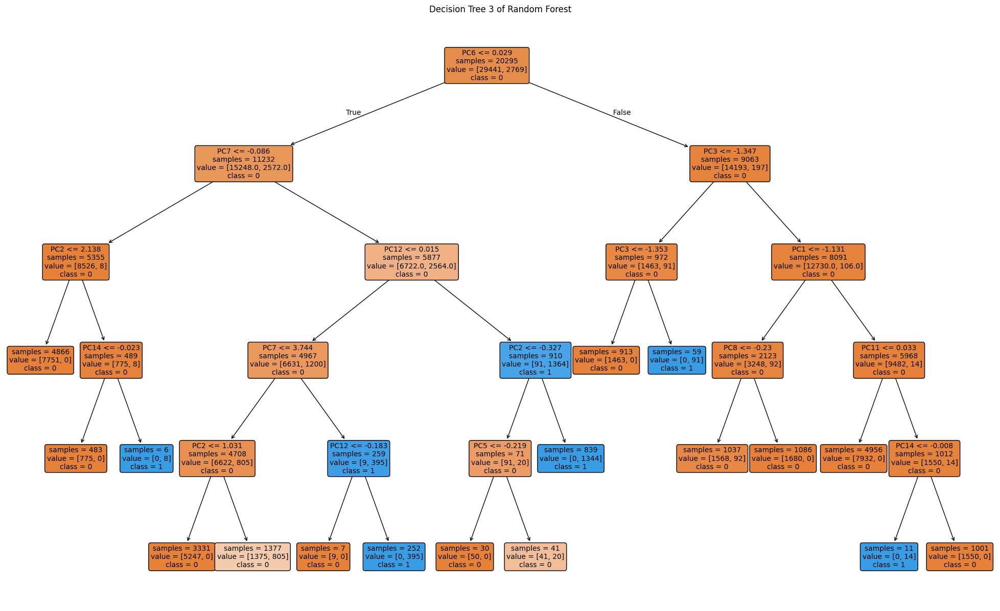

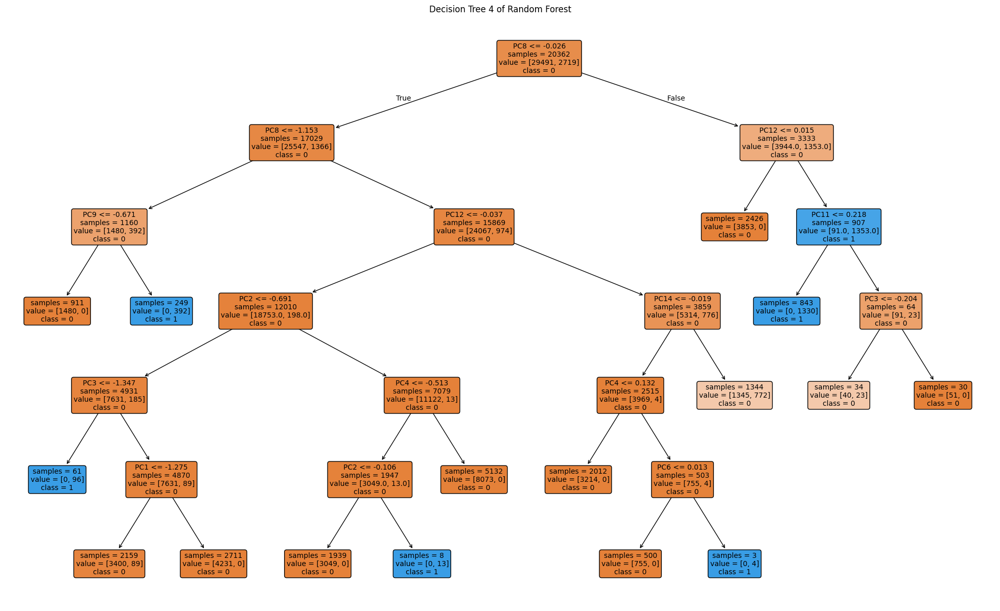

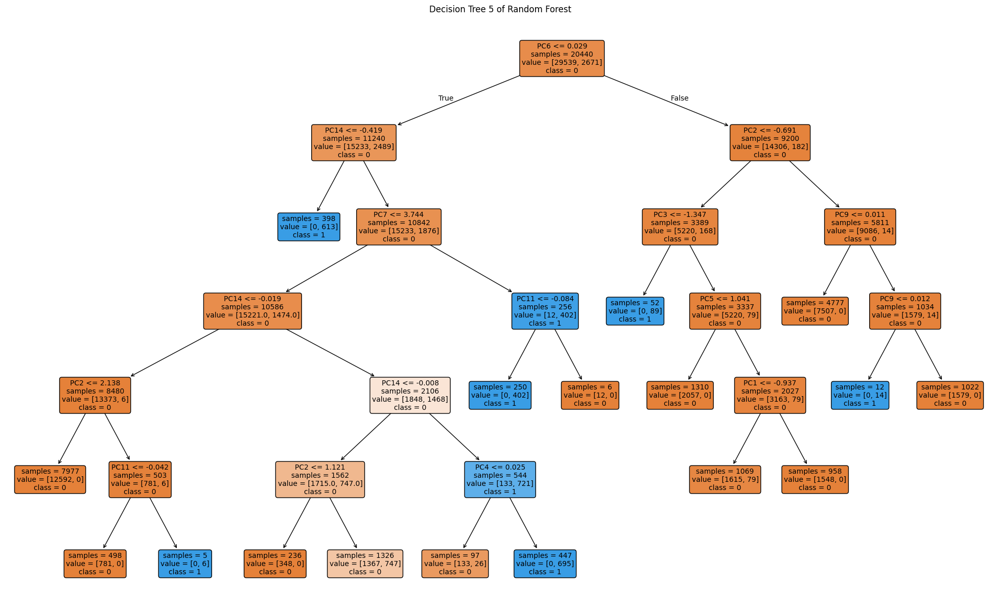

...

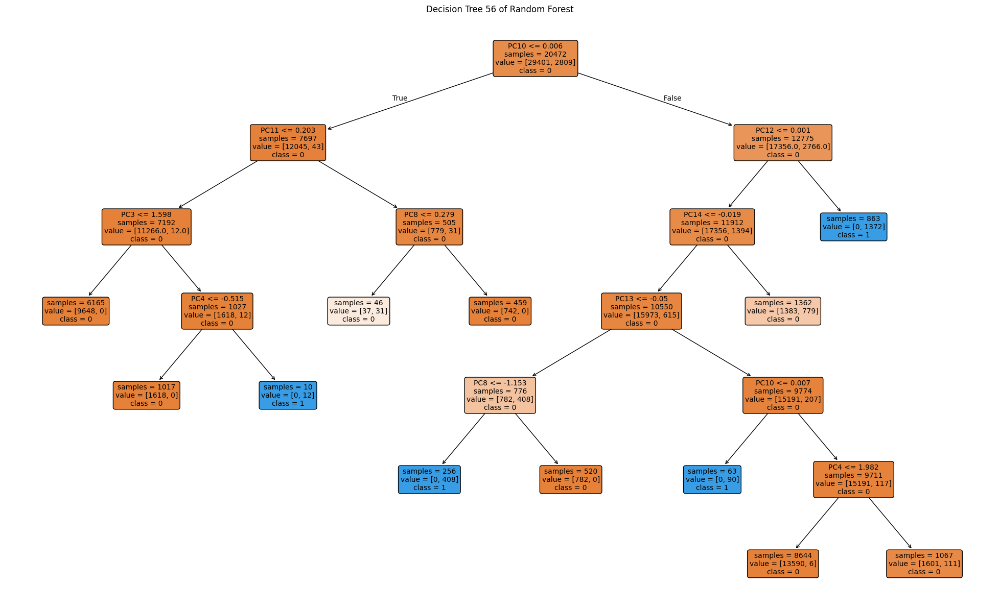

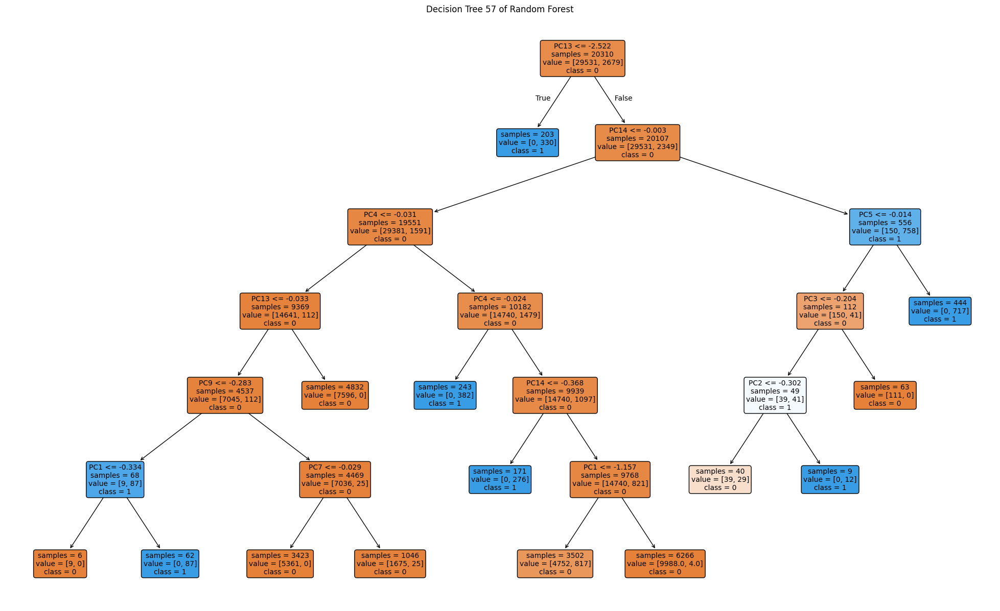

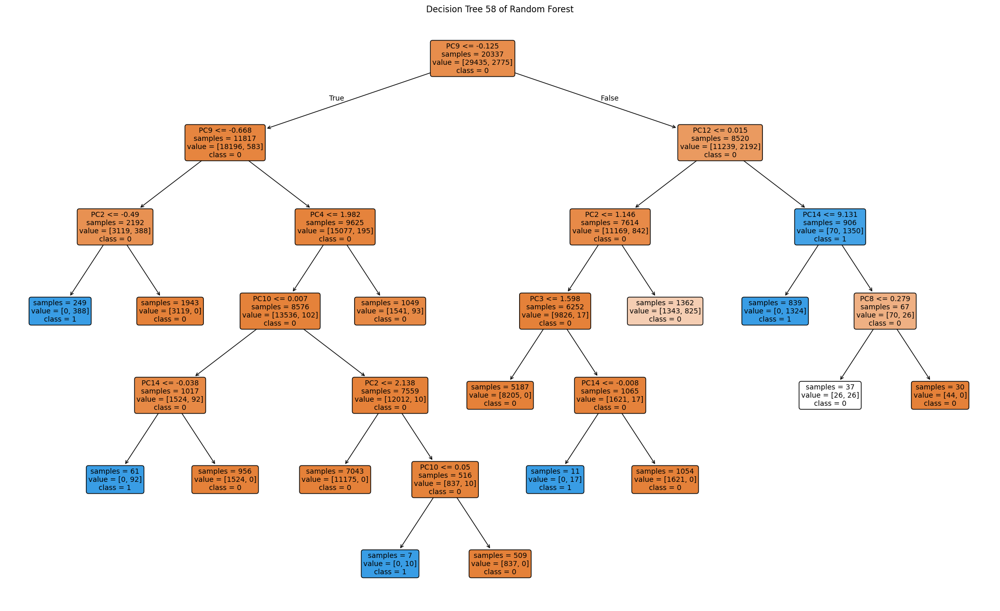

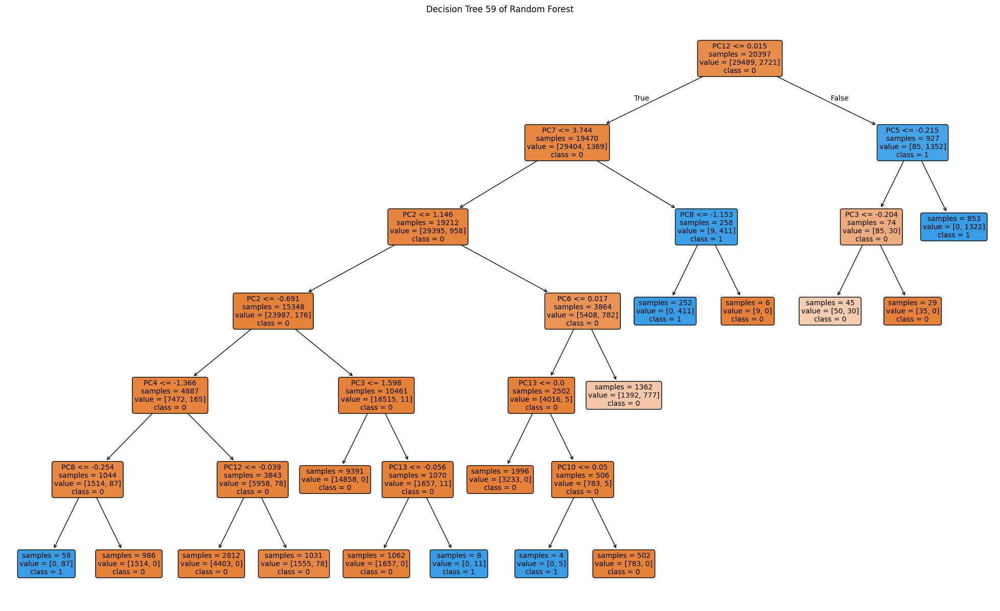

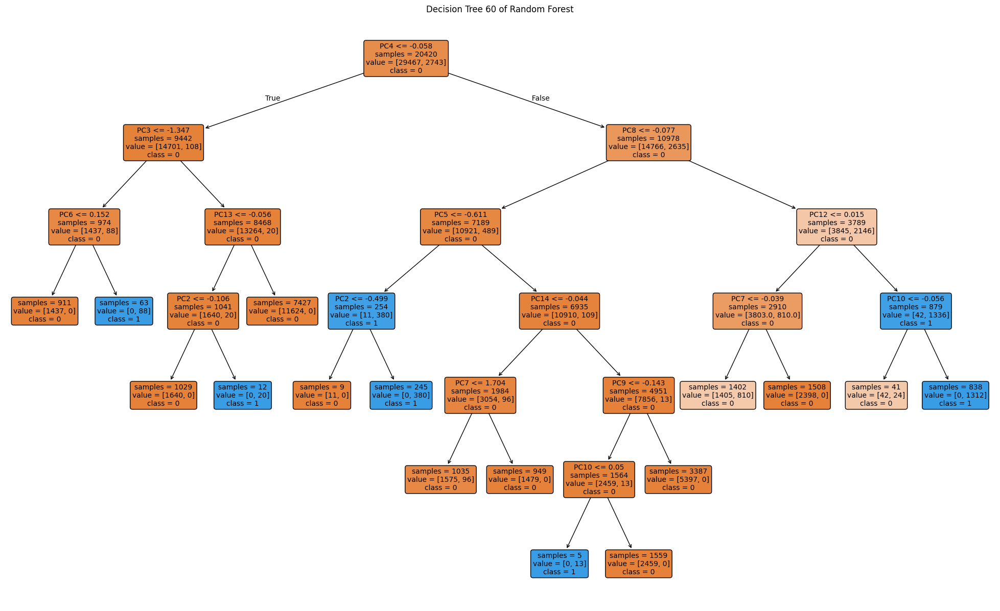

In [108]:
# Run this code to see the structure of each individual trees, commented out since it takes up space

# for i, estimator in enumerate(RF_model_pca.estimators_):
#     fig, ax = plt.subplots(figsize=(25,15))
#     plot_tree(estimator,
#               feature_names = [f"PC{i+1}" for i in range(X_train_PCA.shape[1])],
#               class_names=['0', '1'],
#               rounded=True, impurity=False, ax=ax, filled=True, fontsize=10)
#     plt.title(f"Decision Tree {i+1} of Random Forest")
#     plt.show()

## Final Model Selection

The model I selected to build the interactive map, which predicts where species with toxic PCB levels are likely to be found, is the Random Forest model without PCA.  

This model was chosen over the Decision Tree because Random Forests generally perform better at mitigating overfitting, particularly with imbalanced data. While the Random Forest model with PCA and scaled data showed slightly higher recall and F1 scores (recall: 0.69 vs. 0.66, F1: 0.81 vs. 0.80), I prioritized retaining all feature variables (14 vs. 17) to ensure the model is better suited for deployment purposes.